<a href="https://colab.research.google.com/github/MaiNga-uit/CS2225.CH1507/blob/master/source_code/%5BCS2225_CH1501%5D6_fruits_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Giới thiệu sơ lược bài toán:
* Task: nhận dạng trái cây thuộc 6 loại sau: thanh long, măng cụt, mận, ổi, xoài, khế
* Input: ảnh chứa 1 (hoặc nhiều) loại trái cây trong 6 loại kể trên
* Output: vị trí của trái cây và tên tương ứng

* API/Framework:
<br>Nhóm sử dụng Tensorflow Object Detection API (version 2) để thực hiện bài toán.

#Bước 1. Clone the tensorflow models repository từ github về:

In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

#Bước 2. Cài đặt Object Detection API và import những thư viện cần thiết:

In [ ]:
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

##Test model:

In [ ]:
#run model builder test
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py


#Bước 3. Download dataset của nhóm từ Roboflow:
* Dataset này đã được nhóm gán nhãn và upload lên roboflow

* Dataset bao gồm:

  * Tập train: 1566 hình 
    * được generate dựa trên 512 hình (80% dataset)
    * kèm thêm các bước tiền xử lý và gia tẳng bộ ảnh, bao gồm:
      * resize: 416x416 (fit white background)
      * rotation: -45 độ và +45 độ
      * shear: +-15 Horizontal, +-15 Vertical
      * brightness: +-20%
      * blur: up to 5px
      * noise: up to 5%
  * Tập test: 130 hình (20%)
(Link github để view dataset: https://github.com/MaiNga-uit/CS2225.CH1507)

* **Link download file .tfrecord cho train set và test set từ roboflow**: https://app.roboflow.com/ds/6kyOg1KHvY?key=9NoENEKLqj



In [ ]:
#Downloading data from Roboflow
#UPDATE THIS LINK - get our data from Roboflow
%cd /content

!curl -L "https://app.roboflow.com/ds/6kyOg1KHvY?key=9NoENEKLqj" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


#Bước 4. Những config cần thiết trước khi build model:
- Config path: 
  
  *   train_record_fname: path của file train .tfrecord
  *   test_record_fname: path của file test .tfrecord
  *   label_map_pbtxt_fname: path của file label name

- Mount drive để lưu file model sau khi build
- Config num_steps, hiện tại chỉnh về 2000 step.


In [2]:
# NOTE: Sau khi down xong ở bước 4, ta sẽ có 2 folder là train và test trong đó sẽ có file .tfrecord và label.pbtxt.
# Config path như sau:
test_record_fname = '/content/test/vn-fruits.tfrecord'
train_record_fname = '/content/train/vn-fruits.tfrecord'
label_map_pbtxt_fname = '/content/train/vn-fruits_label_map.pbtxt'

In [ ]:
##change chosen model to deploy different models available in the TF2 object detection zoo
MODELS_CONFIG = {
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d1': {
        'model_name': 'efficientdet_d1_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d1_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d1_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d2': {
        'model_name': 'efficientdet_d2_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d2_768x768_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d2_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
        'efficientdet-d3': {
        'model_name': 'efficientdet_d3_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d3_896x896_coco17_tpu-32.config',
        'pretrained_checkpoint': 'efficientdet_d3_coco17_tpu-32.tar.gz',
        'batch_size': 16
    }
}

chosen_model = 'efficientdet-d0'

num_steps = 2000 #The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing. 
num_eval_steps = 500 #Perform evaluation after so many steps

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size']

In [ ]:
#download pretrained weights
%mkdir /content/models/research/deploy/
%cd /content/models/research/deploy/
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

In [ ]:
#download base training configuration file
%cd /content/models/research/deploy
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

In [ ]:
#prepare
pipeline_fname = '/content/models/research/deploy/' + base_pipeline_file
fine_tune_checkpoint = '/content/models/research/deploy/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)


In [ ]:
#write custom configuration file by slotting our dataset, model checkpoint, and training parameters into the base pipeline file

import re

%cd /content/models/research/deploy
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    
    #fine-tune checkpoint type
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)
        
    f.write(s)



In [ ]:
#In file base pipeline
%cat /content/models/research/deploy/pipeline_file.config

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
pipeline_file = '/content/models/research/deploy/pipeline_file.config'
model_dir = '/content/drive/MyDrive/CS2225_train/output_model'

#Bước 5. Train model

* pipeline_file: defined above in writing custom training configuration
* model_dir: the location tensorboard logs and saved model checkpoints will save to
* num_train_steps: how long to train for
* num_eval_steps: perform eval on validation set after this many steps







In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

**Đánh giá**

In [ ]:
#NOTE: Có thể skip qua bước run này vì thời gian thực thi lâu.
# Code bên dưới dùng để run evaluation cho model. 
# Hiện tại code đánh giá chưa ổn định, thời gian thực thi lâu nên có skip qua bước run này
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir}

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/CS2225_train/output_model'

<IPython.core.display.Javascript object>

## Save output_model


In [ ]:
#see where our model saved weights
%ls '/content/drive/MyDrive/CS2225_train/output_model'

In [ ]:
#run conversion script
import re
import numpy as np

output_directory = '/content/drive/MyDrive/CS2225_train/result_model'

#place the model weights you would like to export here
last_model_path = '/content/drive/MyDrive/CS2225_train/output_model'
print(last_model_path)
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

#Bước 6: Test model với 1 hình ảnh bất kỳ:
Cách test: cung cấp URL download image, chương trình sẽ download và đưa ra kết quả dự đoán <br>
**Lưu ý:** Truy cập file testing đã được tạo riêng biệt để test thuận tiện bằng nhiều phương pháp test khác nhau (chụp hình từ webcam, input 1 hoặc nhiều ảnh, download ảnh từ internet về để test) <br>
**Link truy cập file testing**: https://colab.research.google.com/drive/1rUtFu2oJvqz09lz9KJUizpNe3CKNnLHe#scrollTo=82uQG5G-LSmt


In [ ]:

import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
#recover our saved model
pipeline_config = pipeline_file
#generally you want to put the last ckpt from training in here
model_dir = '/content/drive/MyDrive/CS2225_train/output_model/ckpt-3'
configs = config_util.get_configs_from_pipeline_file('/content/drive/MyDrive/CS2225_train/result_model/pipeline.config')
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join('/content/drive/MyDrive/CS2225_train/output_model/ckpt-3'))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

In [ ]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap('/content/train/vn-fruits_label_map.pbtxt')
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

Downloading...
From: https://lh3.googleusercontent.com/proxy/xTKpdsmsEMA-Jjmopu9-aTynI8DB93CuAAPgMCZlrSjzK9EyRcWW9wUPcDmkVLQW9f7IDDBRkXvSDts9xEa1UkMOx0l_Coc
To: /content/test_img.jpg
100%|██████████| 94.2k/94.2k [00:00<00:00, 59.0MB/s]


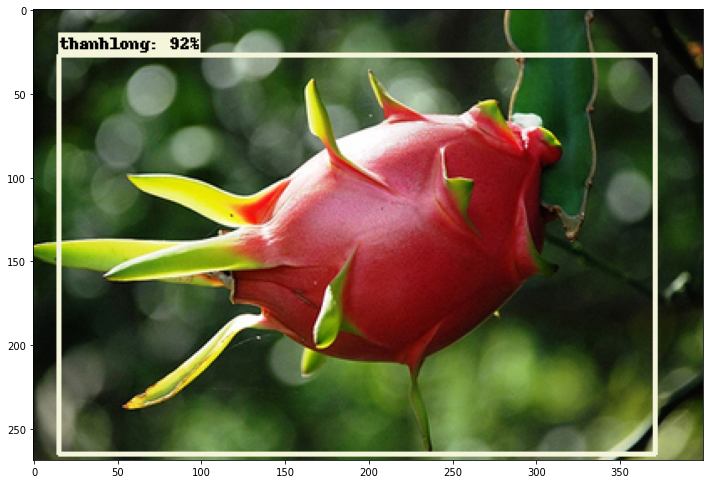

In [ ]:
import random
import glob
import cv2

import gdown

# Cung cấp url để download 1 hình về để test
imgUrl = 'https://lh3.googleusercontent.com/proxy/xTKpdsmsEMA-Jjmopu9-aTynI8DB93CuAAPgMCZlrSjzK9EyRcWW9wUPcDmkVLQW9f7IDDBRkXvSDts9xEa1UkMOx0l_Coc'

gdown.download(imgUrl, '/content/test_img.jpg', quiet=False)

img = '/content/test_img.jpg'

image_np = load_image_into_numpy_array(img)
input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.8,
      agnostic_mode=False,
      line_thickness=3
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()